In [1]:
import os

import altair as alt

import numpy as np
from sklearn.decomposition import PCA
import pandas as pd

import matplotlib
from matplotlib.lines import Line2D
import matplotlib.pyplot as plt


from utils import load_hidden_representations_from_hdf5, read_templates_from_file

----

In [2]:
# params
log_dir = "/logfiles"
model = "google-t5-xl-lm-adapt"
module = "encoder"
task = "rte"

In [3]:
# assertions
assert model == "google-t5-xl-lm-adapt"
assert module == "encoder"
assert task == "rte"

## Prompts

In [4]:
df = read_templates_from_file(f"/t0-analysis/prompts/{task}/all.csv")
# df = read_templates_from_file(f"/t0-analysis/prompts/{task}/fixed_prompt.csv")
# df = read_templates_from_file(f"/t0-analysis/prompts/{task}/fixed_target_yes_no.csv")
display(df)

,name,template,category,includes_targets,targets,target_ids,shuffle
0,gpt_3_yes_no_with_targets,{premise} Question: {hypothesis} Yes or No?,instructive,True,"▁Yes, ▁No, ▁yes, ▁no","0, 1, 0, 1",False
1,mnli_crowdsource_with_targets,"{premise} Using only the above description and what you know about the world, is ""{hypothesis}"" definitely correct? Yes or No?",instructive,True,"▁Yes, ▁No, ▁yes, ▁no","0, 1, 0, 1",False
2,based_on_previous_passage_with_targets,"{premise} Based on the previous passage, is it true that ""{hypothesis}""? Yes or No?",instructive,True,"▁Yes, ▁No, ▁yes, ▁no","0, 1, 0, 1",False
3,infer_with_targets,"Suppose {premise} Can we infer that ""{hypothesis}""? Yes or No?",instructive,True,"▁Yes, ▁No, ▁yes, ▁no","0, 1, 0, 1",False
4,follow_with_targets,Given that {premise} Does it follow that {hypothesis} Yes or No?,instructive,True,"▁Yes, ▁No, ▁yes, ▁no","0, 1, 0, 1",False
5,imply_with_targets,"{premise} Question: Does this imply that ""{hypothesis}""? Yes or No?",instructive,True,"▁Yes, ▁No, ▁yes, ▁no","0, 1, 0, 1",False
6,guaranteed_with_targets,"Given {premise} Is it guaranteed true that ""{hypothesis}""? Yes or No?",instructive,True,"▁Yes, ▁No, ▁yes, ▁no","0, 1, 0, 1",False
7,justified_with_targets,"{premise} Are we justified in saying that ""{hypothesis}""? Yes or No?",instructive,True,"▁Yes, ▁No, ▁yes, ▁no","0, 1, 0, 1",False
8,must_be_true_with_targets,"Given that {premise} Therefore, it must be true that ""{hypothesis}""? Yes or No?",instructive,True,"▁Yes, ▁No, ▁yes, ▁no","0, 1, 0, 1",False
9,should_assume_with_targets,"Given {premise} Should we assume that ""{hypothesis}"" is true? Yes or No?",instructive,True,"▁Yes, ▁No, ▁yes, ▁no","0, 1, 0, 1",False


In [5]:
use_pattern = [
    "gpt_3_yes_no_with_targets",
    # "mnli_crowdsource_with_targets",
    # "based_on_previous_passage_with_targets",
    # "infer_with_targets",
    # "follow_with_targets",
    # "imply_with_targets",
    "guaranteed_with_targets",
    # "justified_with_targets",
    "must_be_true_with_targets",
    # "should_assume_with_targets",
    # "gpt_3_true_false_with_targets",
    "gpt_3_cat_dog_with_targets",
    # "gpt_3_cat_dog_with_targets_yes_no",
    # "gpt_3_yes_no_without_targets",
    # "words_appear_with_targets",
    # "similar_words_with_targets",
    # "start_with_the_with_targets",
    # "same_meaning_with_targets",
    # "paraphrase_with_targets",
    # "paraphrase_r_with_targets",
    # "summarize_with_targets",
    # "inflection_with_targets",
    "null_pattern_with_targets",
    # "null_pattern_r_with_targets",
    # "null_pattern_without_targets",
    # "null_pattern_r_without_targets",
    # "premise_only_with_targets",
    # "premise_only_without_targets",
    # "hypothesis_only_with_targets",
    # "hypothesis_only_without_targets",
]

In [6]:
# load prompted inputs and labels
df_inputs = {}
for _, row in df.iterrows():
    prompt = row['name']
    if prompt in use_pattern:
        df_inputs[prompt] = pd.read_csv(f"/logfiles/{task}/{model}/{module}/{prompt}/prompted_samples.csv", sep='\t', index_col=0)


In [7]:
# load decoded predictions
df_outputs = {}
for _, row in df.iterrows():
    prompt = row['name']
    if prompt in use_pattern:
        df_outputs[prompt] = pd.read_csv(f"/logfiles/{task}/{model}/{module}/{prompt}/decoded_predictions.csv", sep='\t', names=['predicitons'])

## PCA

In [8]:
def unison_shuffled_copies(a, b):
    # from: https://stackoverflow.com/questions/4601373/better-way-to-shuffle-two-numpy-arrays-in-unison
    assert len(a) == len(b)
    p = np.random.permutation(len(a))
    return a[p], b[p]

In [9]:
# for layer in range(0, 10):
for layer in range(0, 25):
# for layer in range(24, 25):
    print('layer=', layer)
    file_names, prompt_names = [], []

    for _, row in df.iterrows():
        if row['name'] in use_pattern:
            # file_names.append(f"{task}/{model}/{module}/{row['name']}/hidden_represenations_layer{layer}_avg.hdf5",)
            file_names.append(f"{task}/{model}/{module}/{row['name']}/hidden_represenations_layer{layer}_avg-nopad.hdf5",)
            prompt_names.append(row['name'])


    # load hidden representations from hdf5 file
    representations = None
    classes = []
    n_sequences = 0

    for idx, file_name in enumerate(file_names):
        hidden_representations = load_hidden_representations_from_hdf5(os.path.join(log_dir, file_name))
        # print(hidden_representations.shape)
        n_sequences = hidden_representations.shape[0]

        if representations is None:
            representations = hidden_representations
        else:
            representations = np.concatenate((representations, hidden_representations), axis=0)

        classes += n_sequences * [idx] # assign representations to classes
    
    classes = np.asarray(classes)

    # shuffle representations and classes
    X, y = unison_shuffled_copies(representations, classes)
    print(X.shape, y.shape)

    # perform PCA on hidden representations
    print('PCA for prompts:', prompt_names)

    for n_components in range(1, 3):
        pca = PCA(n_components=n_components)
        pca.fit(X)

        # variance explained by each of the principal components
        print(f"model:{model}; module:{module}; layer:{layer}; n_components: {n_components}; variance explained: {pca.explained_variance_ratio_}")
        print(np.sum(pca.explained_variance_ratio_))
    print('\n')


layer= 0


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5730.49it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:0; n_components: 1; variance explained: [0.05301229]
0.05301229
model:google-t5-xl-lm-adapt; module:encoder; layer:0; n_components: 2; variance explained: [0.05301233 0.04278556]
0.09579789


layer= 1


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5948.42it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:1; n_components: 1; variance explained: [0.12748757]
0.12748757
model:google-t5-xl-lm-adapt; module:encoder; layer:1; n_components: 2; variance explained: [0.12748742 0.09542312]
0.22291054


layer= 2


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5913.42it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:2; n_components: 1; variance explained: [0.9627438]
0.9627438
model:google-t5-xl-lm-adapt; module:encoder; layer:2; n_components: 2; variance explained: [0.9627438  0.03334992]
0.99609375


layer= 3


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5686.54it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:3; n_components: 1; variance explained: [0.97173595]
0.97173595
model:google-t5-xl-lm-adapt; module:encoder; layer:3; n_components: 2; variance explained: [0.97173613 0.02508999]
0.9968261


layer= 4


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5778.66it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:4; n_components: 1; variance explained: [0.9744215]
0.9744215
model:google-t5-xl-lm-adapt; module:encoder; layer:4; n_components: 2; variance explained: [0.9744217  0.02246927]
0.99689096


layer= 5


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5579.35it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:5; n_components: 1; variance explained: [0.9766994]
0.9766994
model:google-t5-xl-lm-adapt; module:encoder; layer:5; n_components: 2; variance explained: [0.9766994  0.02027441]
0.9969738


layer= 6


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5553.46it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:6; n_components: 1; variance explained: [0.9986618]
0.9986618
model:google-t5-xl-lm-adapt; module:encoder; layer:6; n_components: 2; variance explained: [0.9986618  0.00119548]
0.9998573


layer= 7


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5831.74it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:7; n_components: 1; variance explained: [0.99865174]
0.99865174
model:google-t5-xl-lm-adapt; module:encoder; layer:7; n_components: 2; variance explained: [0.99865174 0.00119337]
0.9998451


layer= 8


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5835.02it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:8; n_components: 1; variance explained: [0.99863464]
0.99863464
model:google-t5-xl-lm-adapt; module:encoder; layer:8; n_components: 2; variance explained: [0.9986344  0.00119396]
0.99982834


layer= 9


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5909.54it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:9; n_components: 1; variance explained: [0.99861175]
0.99861175
model:google-t5-xl-lm-adapt; module:encoder; layer:9; n_components: 2; variance explained: [0.99861175 0.0011924 ]
0.99980414


layer= 10


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5887.53it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:10; n_components: 1; variance explained: [0.99857736]
0.99857736
model:google-t5-xl-lm-adapt; module:encoder; layer:10; n_components: 2; variance explained: [0.99857736 0.00119844]
0.99977577


layer= 11


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5606.11it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:11; n_components: 1; variance explained: [0.99852926]
0.99852926
model:google-t5-xl-lm-adapt; module:encoder; layer:11; n_components: 2; variance explained: [0.9985297  0.00120684]
0.9997365


layer= 12


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5555.45it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:12; n_components: 1; variance explained: [0.9984874]
0.9984874
model:google-t5-xl-lm-adapt; module:encoder; layer:12; n_components: 2; variance explained: [0.9984874  0.00119863]
0.99968606


layer= 13


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5849.00it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:13; n_components: 1; variance explained: [0.998425]
0.998425
model:google-t5-xl-lm-adapt; module:encoder; layer:13; n_components: 2; variance explained: [0.998425  0.0012065]
0.9996315


layer= 14


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5648.99it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:14; n_components: 1; variance explained: [0.99835306]
0.99835306
model:google-t5-xl-lm-adapt; module:encoder; layer:14; n_components: 2; variance explained: [0.99835294 0.00120819]
0.99956113


layer= 15


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5811.29it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:15; n_components: 1; variance explained: [0.9982888]
0.9982888
model:google-t5-xl-lm-adapt; module:encoder; layer:15; n_components: 2; variance explained: [0.9982888  0.00118213]
0.99947095


layer= 16


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5820.55it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:16; n_components: 1; variance explained: [0.9981806]
0.9981806
model:google-t5-xl-lm-adapt; module:encoder; layer:16; n_components: 2; variance explained: [0.99818087 0.00115486]
0.9993357


layer= 17


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5897.42it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:17; n_components: 1; variance explained: [0.99795705]
0.99795705
model:google-t5-xl-lm-adapt; module:encoder; layer:17; n_components: 2; variance explained: [0.9979571 0.0011621]
0.9991192


layer= 18


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 4185.98it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:18; n_components: 1; variance explained: [0.99766636]
0.99766636
model:google-t5-xl-lm-adapt; module:encoder; layer:18; n_components: 2; variance explained: [0.9976663  0.00115655]
0.99882287


layer= 19


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5841.21it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:19; n_components: 1; variance explained: [0.99733263]
0.99733263
model:google-t5-xl-lm-adapt; module:encoder; layer:19; n_components: 2; variance explained: [0.99733263 0.00116012]
0.9984928


layer= 20


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5986.86it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:20; n_components: 1; variance explained: [0.99689054]
0.99689054
model:google-t5-xl-lm-adapt; module:encoder; layer:20; n_components: 2; variance explained: [0.9968904  0.00118107]
0.9980715


layer= 21


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5293.91it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:21; n_components: 1; variance explained: [0.9962286]
0.9962286
model:google-t5-xl-lm-adapt; module:encoder; layer:21; n_components: 2; variance explained: [0.9962286  0.00118334]
0.9974119


layer= 22


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5721.66it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:22; n_components: 1; variance explained: [0.9954708]
0.9954708
model:google-t5-xl-lm-adapt; module:encoder; layer:22; n_components: 2; variance explained: [0.9954708  0.00122017]
0.996691


layer= 23


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5757.15it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:23; n_components: 1; variance explained: [0.994593]
0.994593
model:google-t5-xl-lm-adapt; module:encoder; layer:23; n_components: 2; variance explained: [0.994593   0.00126075]
0.9958538


layer= 24


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 6037.79it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
model:google-t5-xl-lm-adapt; module:encoder; layer:24; n_components: 1; variance explained: [0.0831478]
0.0831478
model:google-t5-xl-lm-adapt; module:encoder; layer:24; n_components: 2; variance explained: [0.0831478  0.04991352]
0.13306132




## Visualize PCA

layer= 0


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5740.99it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:0; n_components: 2; variance explained: [0.05301229 0.04278548]
0.09579777


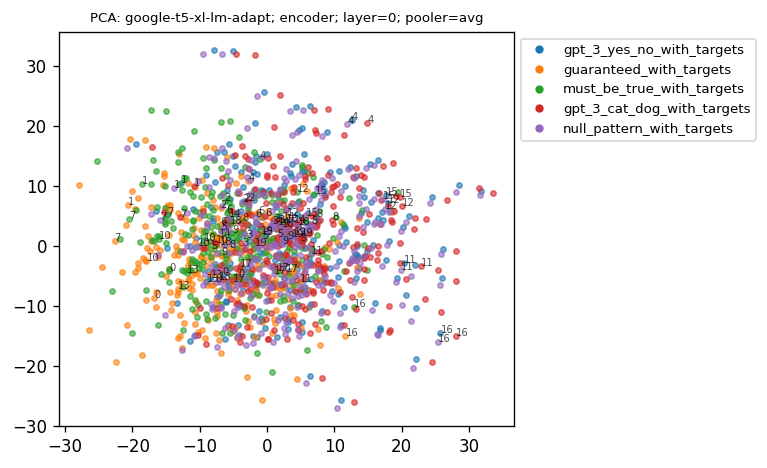



layer= 1


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 6026.64it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:1; n_components: 2; variance explained: [0.12748747 0.09542318]
0.22291064


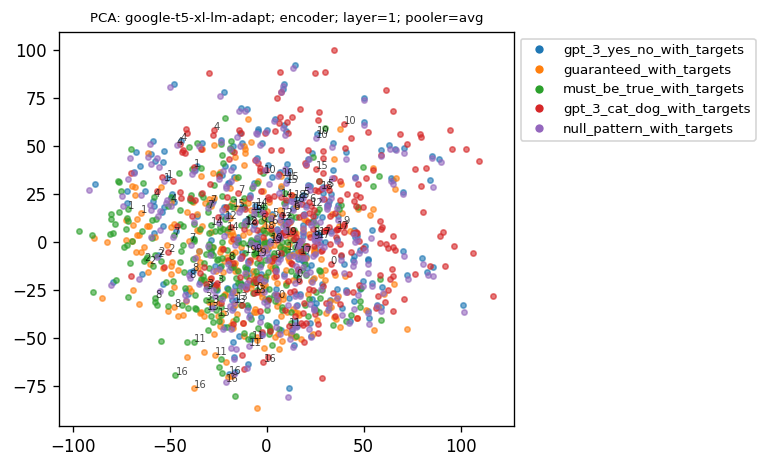



layer= 2


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 6013.70it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:2; n_components: 2; variance explained: [0.9627438  0.03334989]
0.9960937


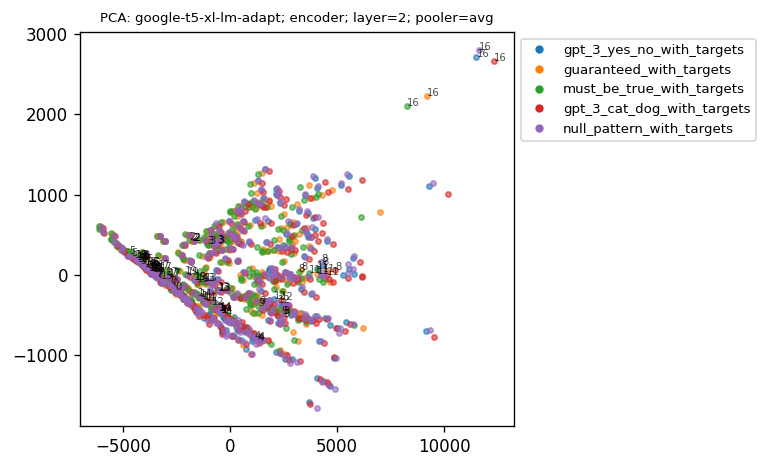



layer= 3


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5068.52it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:3; n_components: 2; variance explained: [0.97173613 0.02509   ]
0.9968261


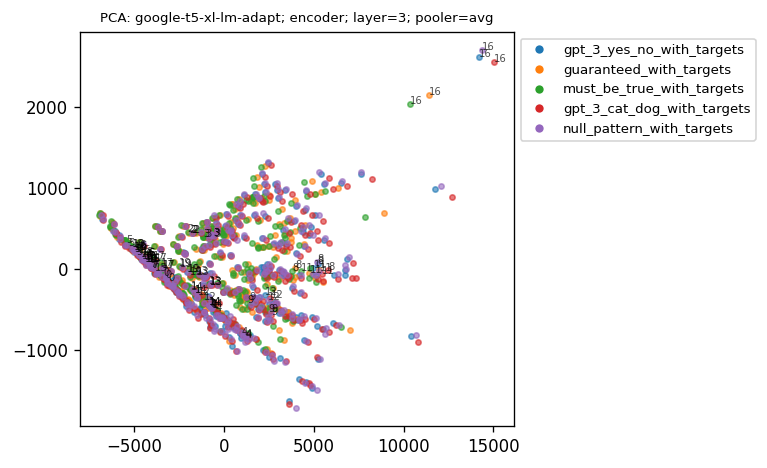



layer= 4


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 6078.80it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:4; n_components: 2; variance explained: [0.9744217  0.02246926]
0.99689096


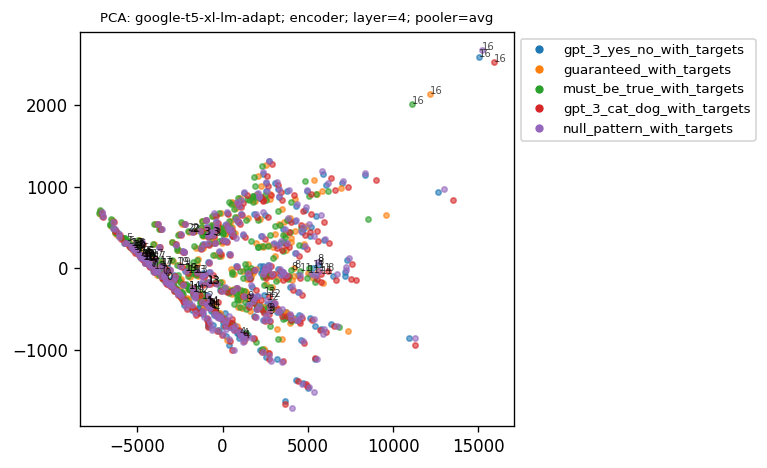



layer= 5


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5571.11it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:5; n_components: 2; variance explained: [0.976699   0.02027443]
0.9969734


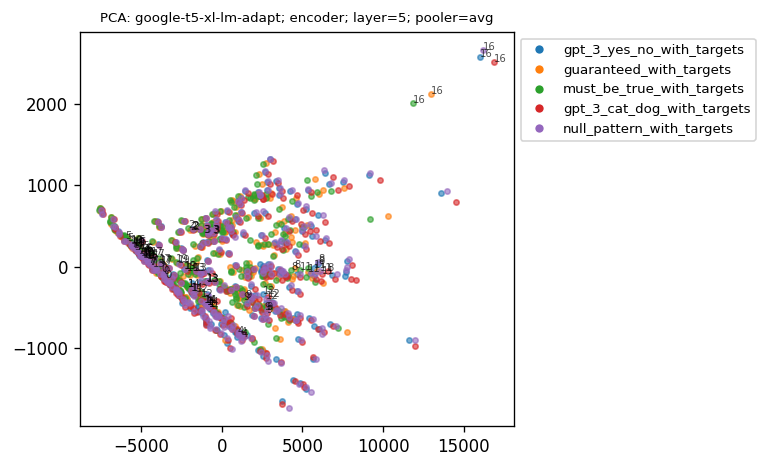



layer= 6


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5535.62it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:6; n_components: 2; variance explained: [0.9986621  0.00119548]
0.9998576


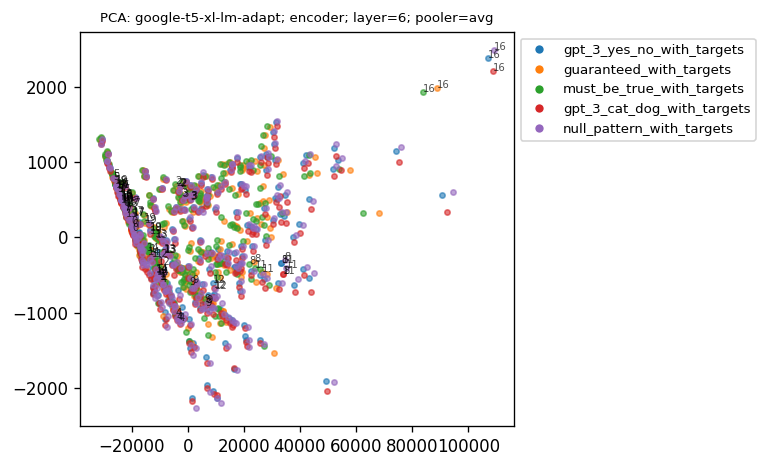



layer= 7


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5951.01it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:7; n_components: 2; variance explained: [0.9986519  0.00119337]
0.99984527


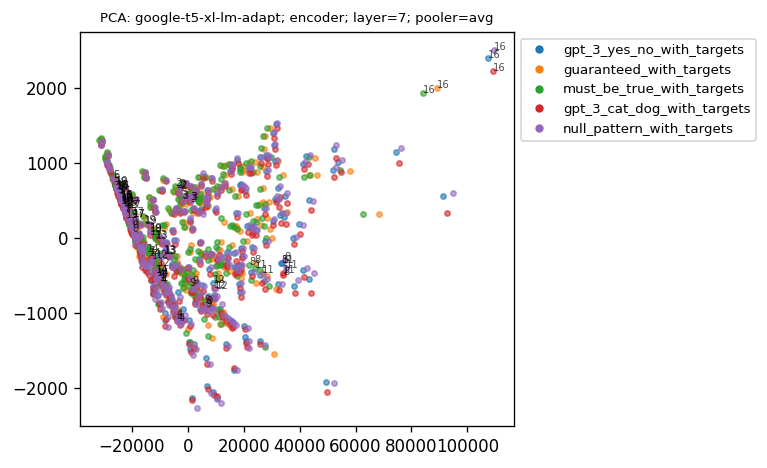



layer= 8


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5647.67it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:8; n_components: 2; variance explained: [0.9986344  0.00119396]
0.99982834


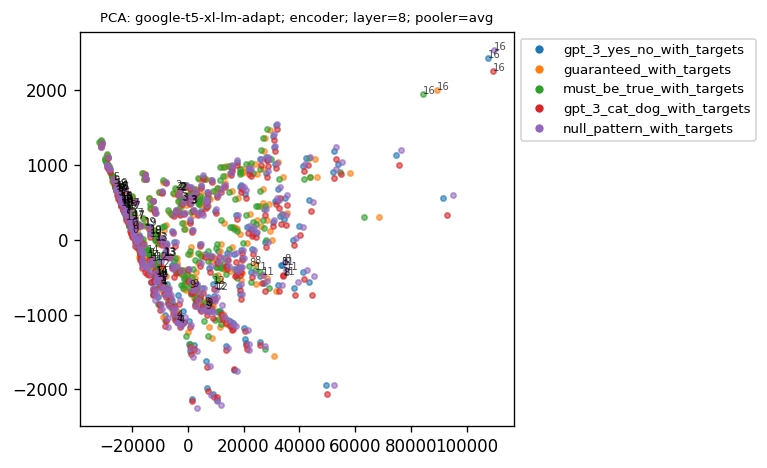



layer= 9


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5422.29it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:9; n_components: 2; variance explained: [0.99861145 0.0011924 ]
0.99980384


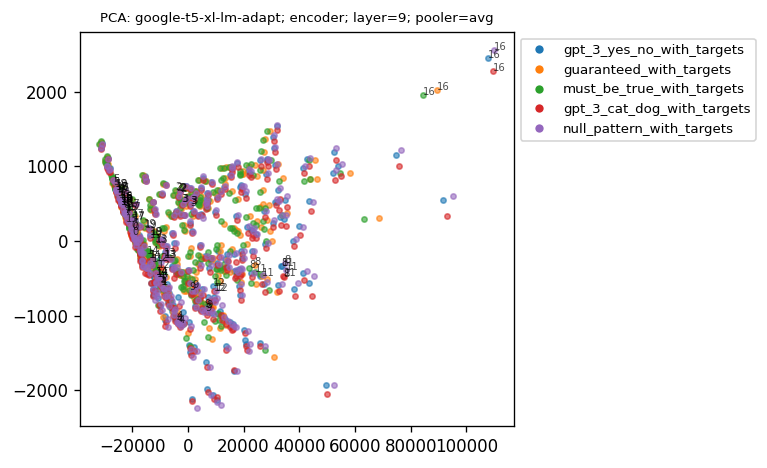



layer= 10


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 6044.01it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:10; n_components: 2; variance explained: [0.99857724 0.00119844]
0.99977565


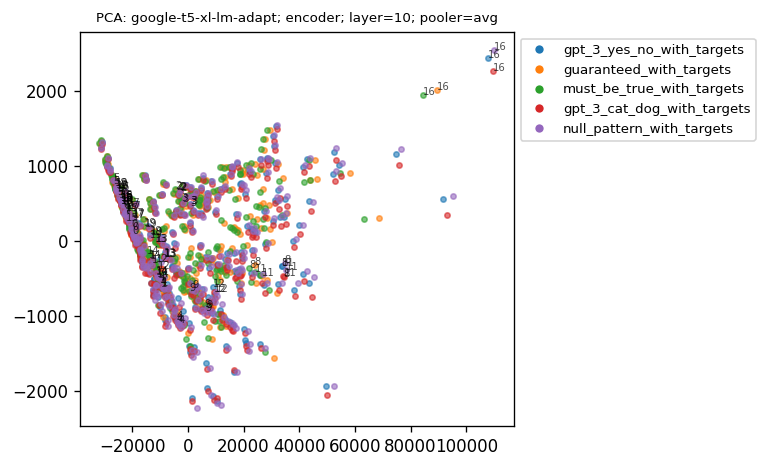



layer= 11


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5573.01it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:11; n_components: 2; variance explained: [0.9985292  0.00120684]
0.999736


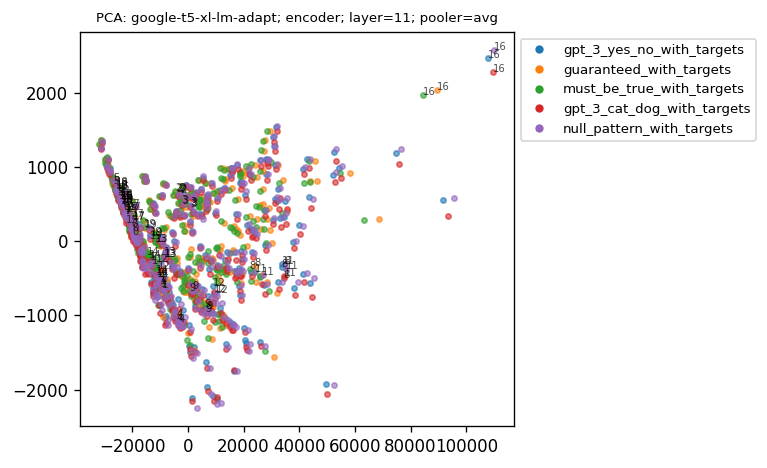



layer= 12


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5892.40it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:12; n_components: 2; variance explained: [0.99848753 0.00119863]
0.9996862


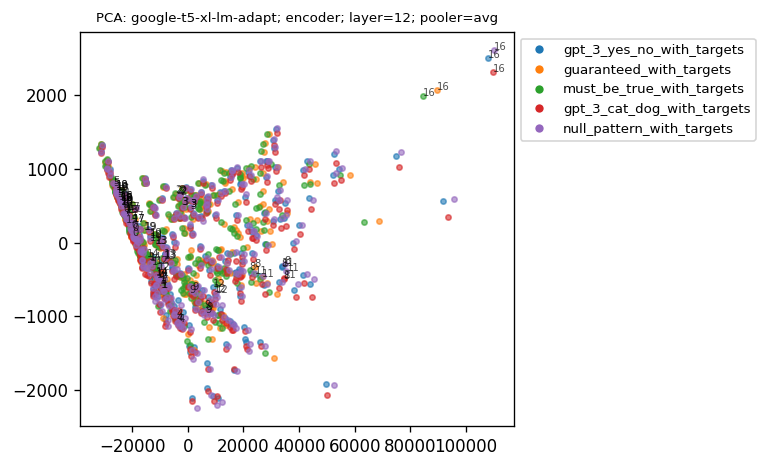



layer= 13


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5719.32it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:13; n_components: 2; variance explained: [0.9984248 0.0012065]
0.99963135


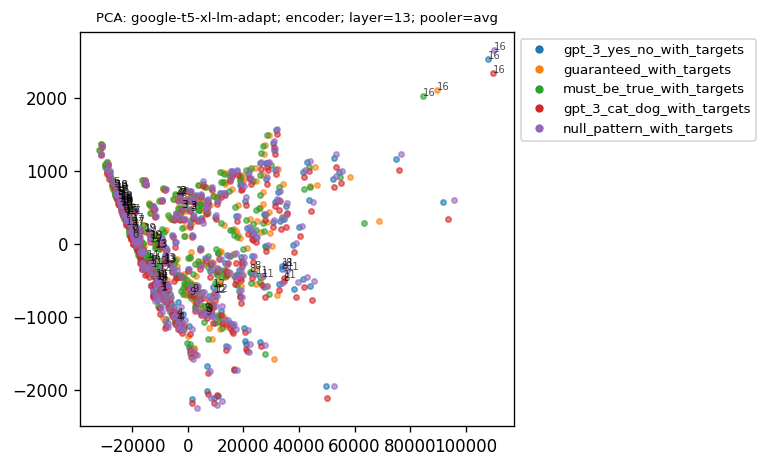



layer= 14


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5925.79it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:14; n_components: 2; variance explained: [0.9983526  0.00120819]
0.9995608


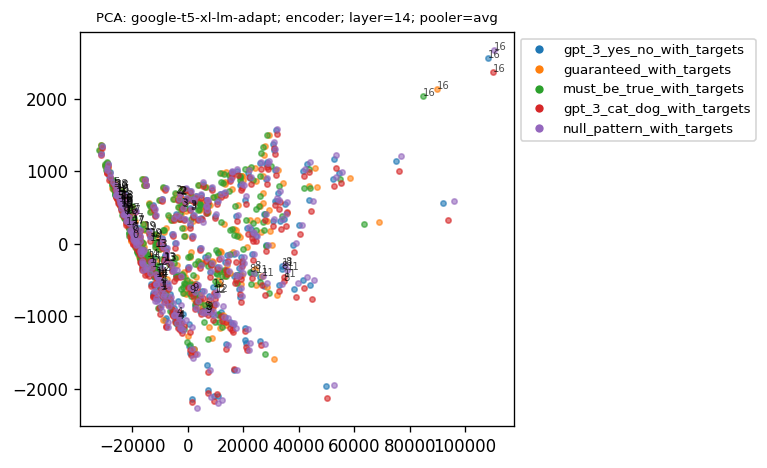



layer= 15


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5868.11it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:15; n_components: 2; variance explained: [0.99828863 0.00118213]
0.9994708


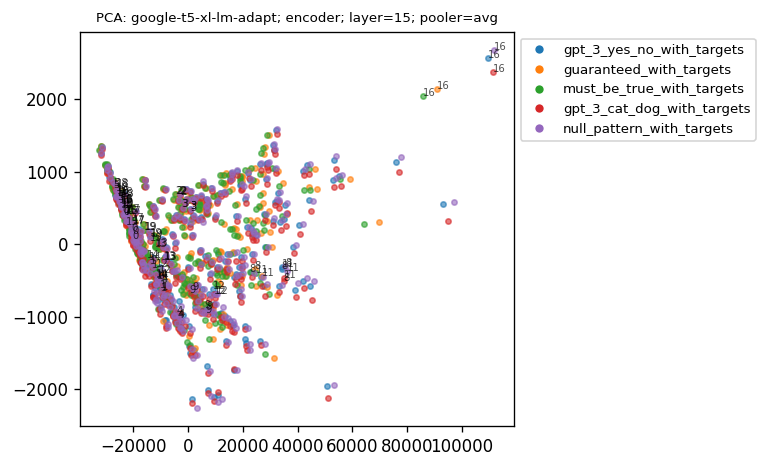



layer= 16


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5854.16it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:16; n_components: 2; variance explained: [0.9981809  0.00115486]
0.99933577


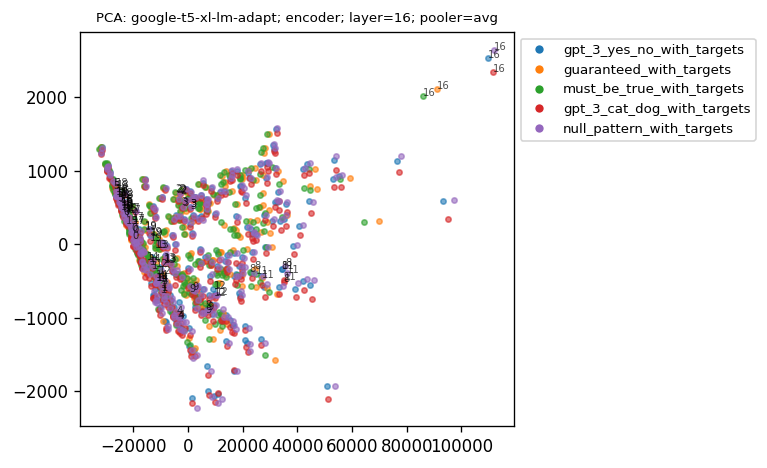



layer= 17


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5872.00it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:17; n_components: 2; variance explained: [0.9979571 0.0011621]
0.9991192


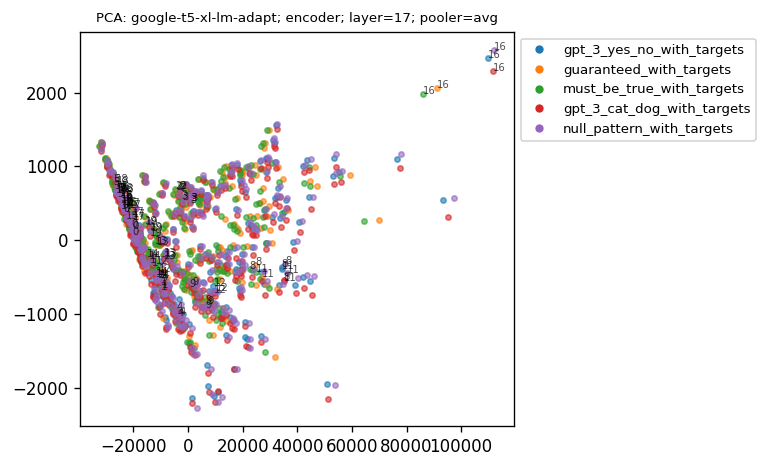



layer= 18


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5975.47it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:18; n_components: 2; variance explained: [0.9976667  0.00115655]
0.9988233


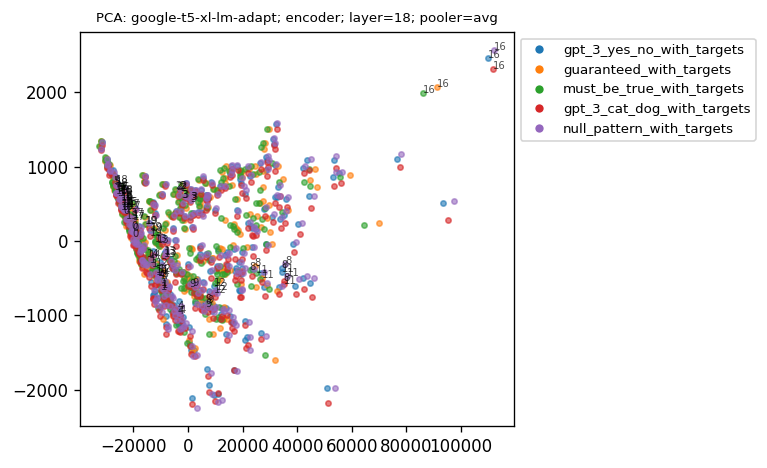



layer= 19


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 6145.22it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:19; n_components: 2; variance explained: [0.997333   0.00116012]
0.99849313


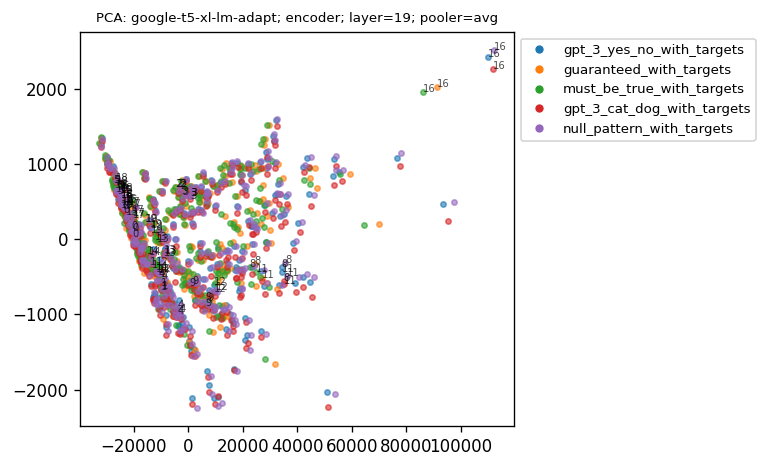



layer= 20


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5933.78it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:20; n_components: 2; variance explained: [0.9968904  0.00118107]
0.9980715


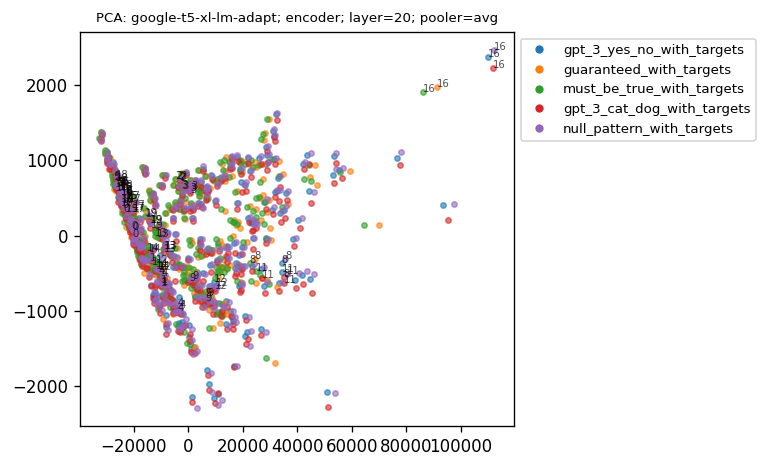



layer= 21


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5906.75it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:21; n_components: 2; variance explained: [0.99622834 0.00118334]
0.99741167


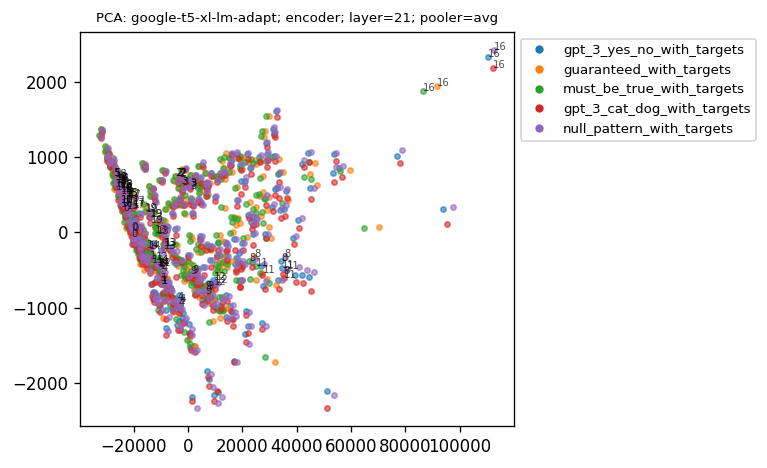



layer= 22


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5351.82it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:22; n_components: 2; variance explained: [0.9954706  0.00122017]
0.99669075


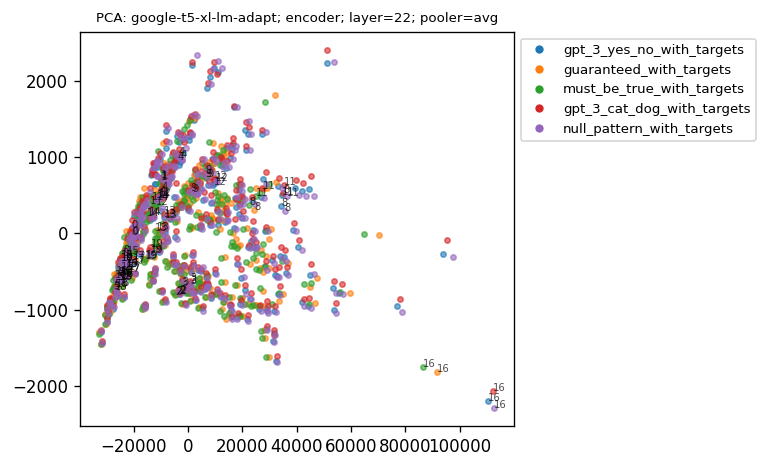



layer= 23


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 5247.45it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:23; n_components: 2; variance explained: [0.9945932  0.00126075]
0.99585396


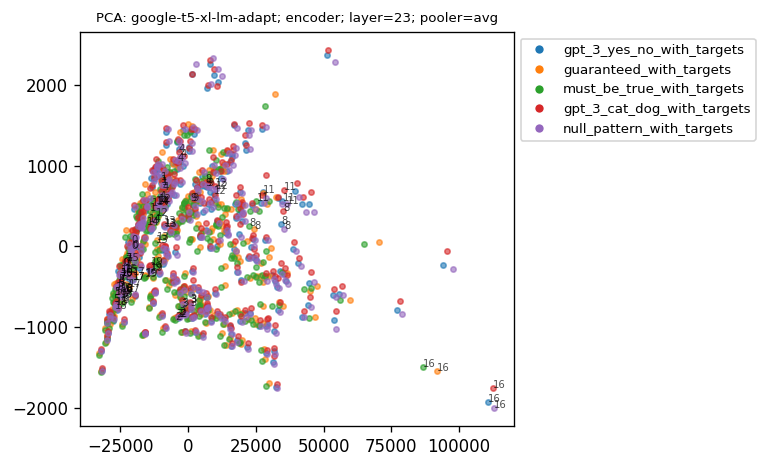



layer= 24


Reading embeddings: 100%|██████████| 277/277 [00:00<00:00, 4820.68it/s]


(1385, 2048) (1385,)
PCA for prompts: ['gpt_3_yes_no_with_targets', 'guaranteed_with_targets', 'must_be_true_with_targets', 'gpt_3_cat_dog_with_targets', 'null_pattern_with_targets']
(1385, 2)
model:google-t5-xl-lm-adapt; module:encoder; layer:24; n_components: 2; variance explained: [0.08314781 0.04991358]
0.1330614


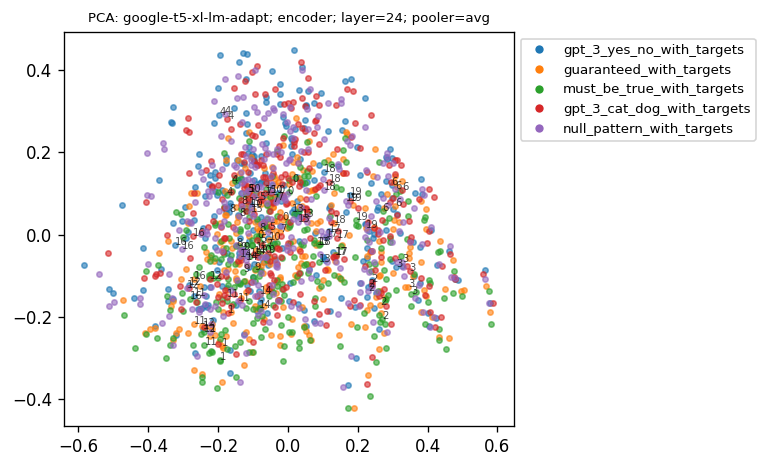

In [10]:
cmap = matplotlib.cm.get_cmap('tab10')
# cmap = matplotlib.cm.get_cmap('tab20')
colors = cmap.colors

layer_dfs = {}

# for layer in range(17, 18):
for layer in range(0, 25):
# for layer in range(24, 25):
    print('layer=', layer)
    file_names, prompt_names = [], []

    tsne_df = {"sid": [], "x": [], "y": [], "template": [], "text": [], "label": [], "prediction": [], "sequence": [], "length": []}

    for _, row in df.iterrows():
        if row['name'] in use_pattern:
            # file_names.append(f"{task}/{model}/{module}/{row['name']}/hidden_represenations_layer{layer}_avg.hdf5",)
            file_names.append(f"{task}/{model}/{module}/{row['name']}/hidden_represenations_layer{layer}_avg-nopad.hdf5",)
            prompt_names.append(row['name'])


    # load hidden representations from hdf5 file
    representations = None
    classes = []
    n_sequences = 0

    for idx, file_name in enumerate(file_names):
        hidden_representations = load_hidden_representations_from_hdf5(os.path.join(log_dir, file_name))
        # print(hidden_representations.shape)
        n_sequences = hidden_representations.shape[0]

        if representations is None:
            representations = hidden_representations
        else:
            representations = np.concatenate((representations, hidden_representations), axis=0)

        classes += n_sequences * [idx] # assign representations to classes
    
    classes = np.asarray(classes)

    X, y = representations, classes
    # shuffle representations and classes
    # X, y = unison_shuffled_copies(representations, classes)
    print(X.shape, y.shape)

    # perform PCA on hidden representations
    print('PCA for prompts:', prompt_names)

    for n_components in range(2, 3):
        n_components = 2
        pca = PCA(n_components=n_components)
        X_pca = pca.fit(X)
        # select components
        pca.components_ = pca.components_[:, :]
        X_pca = X_pca.transform(X)
        print(X_pca.shape)

        # variance explained by each of the principal components
        print(f"model:{model}; module:{module}; layer:{layer}; n_components: {n_components}; variance explained: {pca.explained_variance_ratio_}")
        print(np.sum(pca.explained_variance_ratio_))

        # plot PCA embeddings
        fig, axes = plt.subplots(1, 1, figsize=(6.5,4), dpi=120)
        legend_elements= []

        for idx, file_name in enumerate(file_names):
            x, y = X_pca[n_sequences*idx:n_sequences*(idx + 1), 0], X_pca[n_sequences*idx:n_sequences*(idx + 1), 1]
            axes.scatter(x, y, alpha=0.6, s=[10.0], color=colors[idx])

            # create legend element manually
            legend_elements.append(Line2D([0], [0], marker='o', color='w', label=prompt_names[idx], markerfacecolor=colors[idx], markersize=6))

            # annotate scatter plot with text
            samles_indices = np.random.choice(range(n_sequences), size=20)
            # for i, txt in enumerate(list(range(n_sequences))): # annotate all samples
            # for i, txt in enumerate(samles_indices): # annotate randomly choosen samples
            for i, txt in enumerate(range(20)): # annotate first 10 samples
                axes.annotate(txt, (x[i], y[i]), alpha=0.7, fontsize=6)

            # collect data in dataframe
            for i in range(n_sequences):
                assert len(x) == n_sequences
                tsne_df["sid"].append(i)
                tsne_df["x"].append(x[i])
                tsne_df["y"].append(y[i])
                tsne_df["template"].append(prompt_names[idx])
                tsne_df["text"].append(df_inputs[prompt_names[idx]].iloc[i]["input"])
                tsne_df["label"].append(df_inputs[prompt_names[idx]]['label'].values[i])
                tsne_df["prediction"].append(df_inputs[prompt_names[idx]]['prediction'].values[i])
                tsne_df["sequence"].append(df_outputs[prompt_names[idx]].values[i])
                tsne_df["length"].append(len(df_inputs[prompt_names[idx]].iloc[i]["input"].split()))
        
        layer_dfs[layer] = pd.DataFrame(tsne_df)
        
        axes.set_title(f"PCA: {model}; {module}; layer={layer}; pooler=avg", fontsize=8)
        axes.legend(handles=legend_elements, loc='upper left', bbox_to_anchor=(1.0, 1.0), fancybox=True, shadow=False, fontsize=8)

        plt.tight_layout()

        plt.show()
        plt.close();
        
    print('\n')


## Create interactive altair plots

In [11]:
charts = []
for l in range(25):
    source = layer_dfs[l]
    chart = alt.Chart(source, title=f"PCA: {task}; {model}; {module}; layer={l}; pooler=avg").mark_circle(size=60).encode(
        x='x',
        y='y',
        color='template',
        tooltip=['sid', 'text', 'label', 'prediction', 'sequence']
    ).properties(
        width=500,
        height=400
    )
    charts.append(chart.interactive())

In [12]:
cchart = alt.ConcatChart(concat=charts).resolve_legend(color='independent')

In [13]:
cchart

alt.ConcatChart(...)